# Dog breed classification

## Aalto CS-E4890 - Deep Learning 2019
## Kaarlo Kekkonen

## Introduction

This notebook is comparing different neural networks to determine if any of them is clearly superior, in a classification task. The classification in questio is Kaggle's Dog Breed Identification. The dataset contains 10222 labeled images of dogs, with 120 different dog breeds. The aim is to simply classify, which breed does a image of dog relate to.

In [2]:
from PIL import Image
from pylab import rcParams
from skimage import io, transform
from sklearn.model_selection import train_test_split
from torch.autograd import Variable
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import itertools

import os
import pandas as pd
import datetime
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision

%reload_ext autoreload
%matplotlib inline
torch.cuda.set_device(0)

## Dataloader

I use simple dataloader to load the images. The dataloader-class is defined here. The dataloader combines the image paths and class-labels into a easy-to-use form.

In [3]:
class CSVData(Dataset):
    def __init__(self, label_df, classes, class_indexes, data_dir, transform):
        self.label = label_df
        self.data_dir = data_dir
        self.transform = transform
        self.classes = classes
        self.class_indexes = class_indexes

    def __len__(self):
        return len(self.label) - 1

    def __getitem__(self, idx):
        label = self.label.iloc[idx, 1]
        img_path = os.path.join(self.data_dir, self.label.iloc[idx, 0] + '.jpg')
        image = self.transform(Image.open(img_path).convert('RGB'))

        return image, self.class_indexes[label]

## Transform the data

The transforms are optimal transformations obtained from the kaggle competition.
First the images are resized to 224x224, and then they are normalized, with mean being [0.485, 0.456, 0.406] and std being [0.229, 0.224, 0.225]. All these transformations are expected by pre-trained pytorch models as stated in their documentation.
https://pytorch.org/docs/stable/torchvision/models.html

The images are also randomly flipped horizontally with chance of 50%, to more randomize the data available.

After image transformation is complete, the dataloaders are created. 15% of the data is marked for validation and rest for training.  The dataloaders use batch_size=16 to spare VRAM, though the vram usually peaked at around 4400Mb, roughly half of what I have available. shuffle=True means the dataloaders images are shuffled, and num_workers is set to 0, I could not get it to work with cuda. These settings are not that relevant for the Neural network training etc.

In [4]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}
labels = pd.read_csv('data/labels.csv')

classes = list(labels.breed.unique())
class_indexes = {classes[i]: i for i in range(0, len(classes))}
class_names = classes


train, evaluation = train_test_split(labels, test_size=0.15)
image_datasets = {'train': CSVData(train, classes, class_indexes, 'data/train_images', data_transforms['train']),
                 'test': CSVData(evaluation, classes, class_indexes, 'data/train_images', data_transforms['test'])}


dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16, shuffle=True, num_workers=0)
                  for x in ['train', 'test']}

dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'test']}

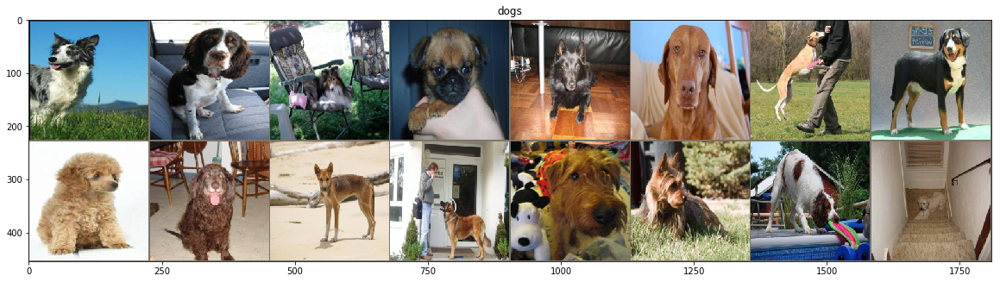

In [63]:
def show_images(inp, title=None, size=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if size:
        plt.figure(figsize=size)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

inputs, classes = next(iter(dataloaders['train']))

out = torchvision.utils.make_grid(inputs)
show_images(out, title='dogs')

### Class distribution

We can see, that the class distribution of the dataset is reasonably good, though the larges class is nearly twice more common than the least common one. This means that the rarest classes like rottweiler and cockerspaniel are classified slightly more rarely than the others. 

This is however not the only problem in classification as several dog breeds appear similar. One example of this is the different labrador variants, their only real difference in appearance is their color.

Another example is Welsh springer spaniel and Brittany, which are mostly similar.

| Welsh springer spaniel | Brittany |
| --- | --- |
| 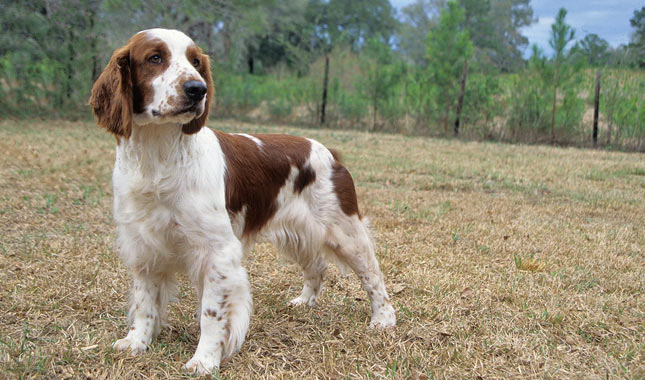  | 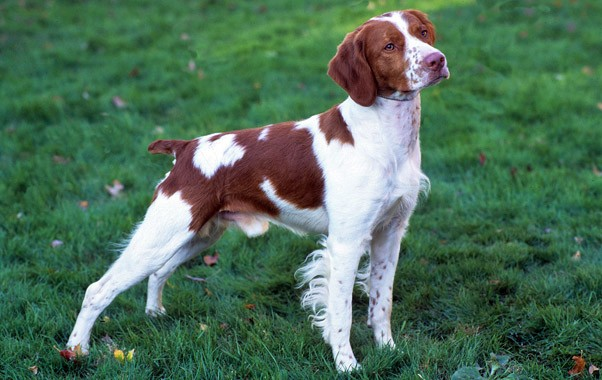 | 

Text(0.5, 1.0, 'Figure 1: Class distribution in the tranining set')

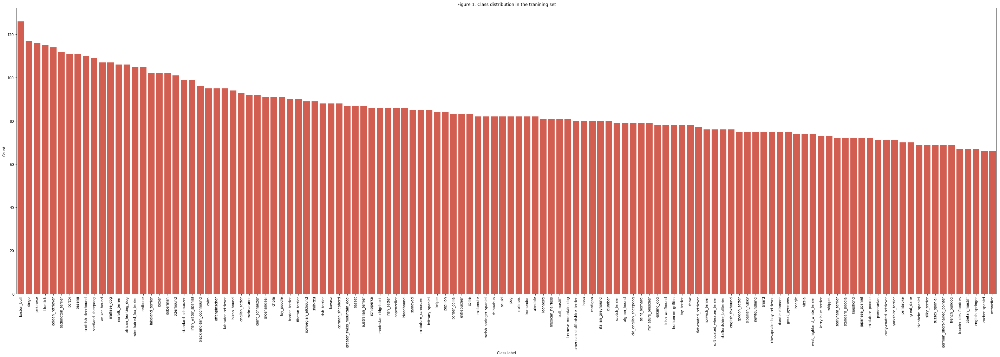

In [5]:
labels_data = pd.read_csv('data/labels.csv')
class_distribution = labels_data["breed"].value_counts()
fig = plt.figure(figsize=(50, 15))
fig.clf()
#ax = plt.subplot()
ax = sns.barplot(x=class_distribution.index, y=class_distribution, color='#e74c3c', ax=plt.subplot())
ax.set_xticklabels(class_names, rotation='vertical', fontsize=10)
ax.set_xlabel('Class label')
ax.set_ylabel('Count')
ax.set_title('Figure 1: Class distribution in the tranining set')

## Training function

Here I define the training function which is used to train each model. The structure of training function is inspired by https://towardsdatascience.com/how-to-train-an-image-classifier-in-pytorch-and-use-it-to-perform-basic-inference-on-single-images-99465a1e9bf5

The training function evaluates the accuracy of the model every 200 steps with the test-dataloader. The accuracy of each 200 steps is not completely accurate, but represents progress in the creation of the model. Default amount of epochs is 25. Finally the model is saved in a file.

The actual files are not on git, since they're too large for it. Compressed models are located in folder compressed_models. They are split to smaller files to avoid gits 100Mb file size limit.

In [138]:
device = torch.device("cuda")

def train_model(model, criterion, optimizer, name, num_epochs=25):
    start_time = datetime.datetime.now()
    steps = 0
    running_loss = 0.0
    print_every = 200
    n_test = len(dataloaders["test"])
    n_train = len(dataloaders["train"])
    train_losses, test_losses = [], []
    for epoch in range(num_epochs):
        for inputs, labels in dataloaders["train"]:
            inputs, labels = inputs.to(device), labels.to(device)
            steps += 1
            optimizer.zero_grad()
            logps = model.forward(inputs)
            loss = criterion(logps, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            if steps % print_every == 0:
                test_loss = 0
                accuracy = 0
                model.eval()
                with torch.no_grad():
                    for inputs, labels in dataloaders["test"]:
                        inputs, labels = inputs.to(device), labels.to(device)
                        logps = model.forward(inputs)
                        batch_loss = criterion(logps, labels)
                        test_loss += batch_loss.item()

                        ps = torch.exp(logps)
                        top_p, top_class = ps.topk(1, dim=1)
                        equals = (top_class == labels.view(*top_class.shape))
                        accuracy +=torch.mean(equals.type(torch.FloatTensor)).item()
                train_losses.append(running_loss/n_train)
                test_losses.append(test_loss/n_test)                    
                print(f"Epoch {epoch+1}/{num_epochs} ", end=' ')
                print(f"Train loss: {running_loss/print_every:.3f}", end=' ')
                print(f"Test loss: {test_loss/n_test:.3f}", end=' ')
                print(f"Test accuracy: {accuracy/n_test:.3f}")
                running_loss = 0.0
                model.train()
    torch.save(model, name + '.pth')
    end_time = datetime.datetime.now()
    timedelta = end_time - start_time
    print(f"It took {timedelta} to train {name}")

## Create the models

### Resnet50 with Single trainable layer

The first model I will train is resnet50 (pretrained). After setting the pretrained model, the layers are "frozen", so the training does not affect them. Then the final layer is set as a single linear layer, which outputs in the 120 dog-classes. 
Then the optimizer is created with optim.SGD. Finally the model is set to cuda device to speed up training.

In [107]:
del resnet_model
resnet_model = models.resnet50(pretrained=True)
for param in resnet_model.parameters():
    param.requires_grad = False

resnet_model.fc = nn.Linear(resnet_model.fc.in_features, len(class_names))

resnet_optimizer = optim.SGD(resnet_model.fc.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

resnet_model = resnet_model.cuda()

### Training Resnet50

In [8]:
train_model(resnet_model, criterion, resnet_optimizer, "resnet50-2")

Epoch 1/25  Train loss: 4.316 Test loss: 3.564 Test accuracy: 0.398
Epoch 1/25  Train loss: 3.258 Test loss: 2.590 Test accuracy: 0.569
Epoch 2/25  Train loss: 2.496 Test loss: 1.916 Test accuracy: 0.698
Epoch 2/25  Train loss: 2.008 Test loss: 1.549 Test accuracy: 0.739
Epoch 2/25  Train loss: 1.692 Test loss: 1.335 Test accuracy: 0.765
Epoch 3/25  Train loss: 1.487 Test loss: 1.169 Test accuracy: 0.769
Epoch 3/25  Train loss: 1.305 Test loss: 1.067 Test accuracy: 0.775
Epoch 3/25  Train loss: 1.200 Test loss: 0.974 Test accuracy: 0.798
Epoch 4/25  Train loss: 1.079 Test loss: 0.898 Test accuracy: 0.792
Epoch 4/25  Train loss: 1.040 Test loss: 0.878 Test accuracy: 0.796
Epoch 5/25  Train loss: 0.985 Test loss: 0.818 Test accuracy: 0.815
Epoch 5/25  Train loss: 0.893 Test loss: 0.816 Test accuracy: 0.803
Epoch 5/25  Train loss: 0.907 Test loss: 0.774 Test accuracy: 0.820
Epoch 6/25  Train loss: 0.869 Test loss: 0.749 Test accuracy: 0.824
Epoch 6/25  Train loss: 0.840 Test loss: 0.758 T

### VGG16
from https://www.kaggle.com/carloalbertobarbano/vgg16-transfer-learning-pytorch

I simply take the pretrained vgg16 model, and replace its last layer with my own, like in the resnet50 above.

In [9]:
vgg_model = models.vgg16(pretrained=True)
for param in vgg_model.parameters():
    param.requires_grad = False

vgg_model.classifier[-1] = nn.Linear(vgg_model.classifier[-1].in_features, len(class_names))
vgg_optimizer = optim.SGD(vgg_model.classifier.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

vgg_model = vgg_model.cuda()

### Training VGG16

In [10]:
train_model(vgg_model, criterion, vgg_optimizer, "vgg16-2")

Epoch 1/25  Train loss: 2.414 Test loss: 1.147 Test accuracy: 0.735
Epoch 1/25  Train loss: 1.102 Test loss: 0.850 Test accuracy: 0.778
Epoch 2/25  Train loss: 0.876 Test loss: 0.751 Test accuracy: 0.790
Epoch 2/25  Train loss: 0.726 Test loss: 0.696 Test accuracy: 0.816
Epoch 2/25  Train loss: 0.722 Test loss: 0.686 Test accuracy: 0.797
Epoch 3/25  Train loss: 0.681 Test loss: 0.668 Test accuracy: 0.803
Epoch 3/25  Train loss: 0.616 Test loss: 0.655 Test accuracy: 0.802
Epoch 3/25  Train loss: 0.619 Test loss: 0.626 Test accuracy: 0.814
Epoch 4/25  Train loss: 0.555 Test loss: 0.647 Test accuracy: 0.810
Epoch 4/25  Train loss: 0.577 Test loss: 0.628 Test accuracy: 0.816
Epoch 5/25  Train loss: 0.548 Test loss: 0.621 Test accuracy: 0.814
Epoch 5/25  Train loss: 0.515 Test loss: 0.626 Test accuracy: 0.804
Epoch 5/25  Train loss: 0.497 Test loss: 0.651 Test accuracy: 0.799
Epoch 6/25  Train loss: 0.514 Test loss: 0.618 Test accuracy: 0.808
Epoch 6/25  Train loss: 0.459 Test loss: 0.631 T

### Resnet152 with multiple trainable layers

This time I will be using resnet152 with more complex trainable layers. I expect that it's accuracy would be at least the same as in the resnet50 previously.

In [7]:
resnet152_model = models.resnet152(pretrained=True)
for param in resnet152_model.parameters():
    param.requires_grad = False

resnet152_model.fc = nn.Sequential(
                nn.Linear(resnet152_model.fc.in_features, 4096),
                nn.ReLU(inplace=True),
                nn.Dropout(p=0.1),
                nn.Linear(4096, len(class_names)),
                nn.ReLU(inplace=True),
                nn.Dropout(p=0.1),
            )

resnet152_optimizer = optim.SGD(resnet152_model.fc.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

resnet152_model = resnet152_model.cuda()

### Training Resnet152

In [8]:
train_model(resnet152_model, criterion, resnet152_optimizer, "resnet152")

Epoch 1/25  Train loss: 4.638 Test loss: 4.371 Test accuracy: 0.256
Epoch 1/25  Train loss: 4.220 Test loss: 3.753 Test accuracy: 0.449
Epoch 2/25  Train loss: 3.710 Test loss: 3.221 Test accuracy: 0.518
Epoch 2/25  Train loss: 3.294 Test loss: 2.815 Test accuracy: 0.566
Epoch 2/25  Train loss: 3.081 Test loss: 2.620 Test accuracy: 0.553
Epoch 3/25  Train loss: 2.867 Test loss: 2.439 Test accuracy: 0.572
Epoch 3/25  Train loss: 2.733 Test loss: 2.284 Test accuracy: 0.596
Epoch 3/25  Train loss: 2.722 Test loss: 2.223 Test accuracy: 0.593
Epoch 4/25  Train loss: 2.615 Test loss: 2.150 Test accuracy: 0.609
Epoch 4/25  Train loss: 2.529 Test loss: 2.099 Test accuracy: 0.621
Epoch 5/25  Train loss: 2.495 Test loss: 2.081 Test accuracy: 0.612
Epoch 5/25  Train loss: 2.525 Test loss: 2.082 Test accuracy: 0.604
Epoch 5/25  Train loss: 2.392 Test loss: 2.031 Test accuracy: 0.622
Epoch 6/25  Train loss: 2.423 Test loss: 2.025 Test accuracy: 0.612
Epoch 6/25  Train loss: 2.449 Test loss: 1.999 T

### Densenet

Trying densenet with the same setup from other networks, this time using densenet.

In [10]:
densenet_model = models.densenet161(pretrained=True)
for param in densenet_model.parameters():
    param.requires_grad = False

densenet_model.classifier = nn.Linear(densenet_model.classifier.in_features, len(class_names))
densenet_optimizer = torch.optim.Adam(densenet_model.parameters())
criterion = nn.CrossEntropyLoss().cuda()

densenet_model = densenet_model.cuda()

In [11]:
train_model(densenet_model, criterion, densenet_optimizer, "densenet")

Epoch 1/25  Train loss: 2.897 Test loss: 1.273 Test accuracy: 0.704
Epoch 1/25  Train loss: 1.220 Test loss: 0.810 Test accuracy: 0.792
Epoch 2/25  Train loss: 0.897 Test loss: 0.699 Test accuracy: 0.793
Epoch 2/25  Train loss: 0.626 Test loss: 0.635 Test accuracy: 0.807
Epoch 2/25  Train loss: 0.592 Test loss: 0.555 Test accuracy: 0.840
Epoch 3/25  Train loss: 0.513 Test loss: 0.552 Test accuracy: 0.837
Epoch 3/25  Train loss: 0.445 Test loss: 0.551 Test accuracy: 0.828
Epoch 3/25  Train loss: 0.458 Test loss: 0.574 Test accuracy: 0.826
Epoch 4/25  Train loss: 0.368 Test loss: 0.559 Test accuracy: 0.825
Epoch 4/25  Train loss: 0.361 Test loss: 0.541 Test accuracy: 0.829
Epoch 5/25  Train loss: 0.330 Test loss: 0.554 Test accuracy: 0.834
Epoch 5/25  Train loss: 0.276 Test loss: 0.532 Test accuracy: 0.834
Epoch 5/25  Train loss: 0.297 Test loss: 0.570 Test accuracy: 0.834
Epoch 6/25  Train loss: 0.271 Test loss: 0.539 Test accuracy: 0.826
Epoch 6/25  Train loss: 0.233 Test loss: 0.552 T

### Alexnet

Here I use the classic alexnet, just as the other networks.

In [139]:
alexnet_model = models.alexnet(pretrained=True)
for param in alexnet_model.parameters():
    param.requires_grad = False
alexnet_model.classifier[-1] = nn.Linear(in_features=alexnet_model.classifier[-1].in_features,
                                         out_features=len(class_names))

alexnet_optimizer = optim.SGD(alexnet_model.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

alexnet_model = alexnet_model.cuda()

In [7]:
train_model(alexnet_model, criterion, alexnet_optimizer, "alexnet")

Epoch 1/25  Train loss: 3.087 Test loss: 2.091 Test accuracy: 0.451
Epoch 1/25  Train loss: 2.274 Test loss: 1.905 Test accuracy: 0.492
Epoch 2/25  Train loss: 1.917 Test loss: 1.731 Test accuracy: 0.530
Epoch 2/25  Train loss: 1.382 Test loss: 1.814 Test accuracy: 0.523
Epoch 2/25  Train loss: 1.489 Test loss: 1.719 Test accuracy: 0.526
Epoch 3/25  Train loss: 1.171 Test loss: 1.747 Test accuracy: 0.536
Epoch 3/25  Train loss: 1.055 Test loss: 1.699 Test accuracy: 0.526
Epoch 3/25  Train loss: 1.104 Test loss: 1.707 Test accuracy: 0.545
Epoch 4/25  Train loss: 0.836 Test loss: 1.674 Test accuracy: 0.548
Epoch 4/25  Train loss: 0.856 Test loss: 1.705 Test accuracy: 0.554
Epoch 5/25  Train loss: 0.860 Test loss: 1.682 Test accuracy: 0.552
Epoch 5/25  Train loss: 0.653 Test loss: 1.707 Test accuracy: 0.557
Epoch 5/25  Train loss: 0.670 Test loss: 1.702 Test accuracy: 0.543
Epoch 6/25  Train loss: 0.673 Test loss: 1.712 Test accuracy: 0.553
Epoch 6/25  Train loss: 0.536 Test loss: 1.780 T

In [140]:
train_model(alexnet_model, criterion, alexnet_optimizer, "alexnet-2")

Epoch 1/25  Train loss: 3.096 Test loss: 2.162 Test accuracy: 0.444
Epoch 1/25  Train loss: 2.290 Test loss: 1.924 Test accuracy: 0.491
Epoch 2/25  Train loss: 1.916 Test loss: 1.833 Test accuracy: 0.492
Epoch 2/25  Train loss: 1.350 Test loss: 1.763 Test accuracy: 0.498
Epoch 2/25  Train loss: 1.493 Test loss: 1.735 Test accuracy: 0.515
Epoch 3/25  Train loss: 1.170 Test loss: 1.765 Test accuracy: 0.514
Epoch 3/25  Train loss: 1.026 Test loss: 1.755 Test accuracy: 0.505
Epoch 3/25  Train loss: 1.185 Test loss: 1.737 Test accuracy: 0.523
Epoch 4/25  Train loss: 0.806 Test loss: 1.752 Test accuracy: 0.532
Epoch 4/25  Train loss: 0.857 Test loss: 1.760 Test accuracy: 0.527
Epoch 5/25  Train loss: 0.852 Test loss: 1.757 Test accuracy: 0.532
Epoch 5/25  Train loss: 0.651 Test loss: 1.679 Test accuracy: 0.538
Epoch 5/25  Train loss: 0.701 Test loss: 1.717 Test accuracy: 0.540
Epoch 6/25  Train loss: 0.643 Test loss: 1.709 Test accuracy: 0.542
Epoch 6/25  Train loss: 0.544 Test loss: 1.759 T

## Evaluation

In this chapter, I evaluate the results gained from the training the networks.

### Confusion matrix

We create confusion matrices for each of our models. Normalized matrices are located in images folder. 

The images are high resolution, and it can be difficult to see the labels without zooming close. Also the grid is very large, but it can be seen that the models are rather accurate. The most inaccurate appears to be resnet152, which is rather sad since it is the most complicated of the bunch.

In [132]:
def plot_confusion_matrix(model, testloader, classes,
                          normalize=False,
                          title='(Humongous) Confusion matrix',
                          cmap=plt.cm.Blues):
    model.eval()
    cm = torch.zeros(len(classes), len(classes))
    with torch.no_grad():
        for i, (inputs, classes_t) in enumerate(testloader):
            inputs = inputs.to(device)
            classes_t = classes_t.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            for t, p in zip(classes_t.view(-1), preds.view(-1)):
                    cm[t.long(), p.long()] += 1

    cm = np.array(cm)   
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(50,50))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=50)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if (cm[i, j] != 0):
            if normalize:
                text = "{0:.2f}".format(cm[i, j])
            else:
                text = "{0:.0f}".format(cm[i, j])
        else:
            text = "0"
        plt.text(j, i, text,
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label', fontsize=40)
    plt.xlabel('Predicted label', fontsize=40)
    plt.tight_layout()

#### Load models from disk

In [135]:
resnet_model = torch.load('resnet50-2.pth')
resnet152_model = torch.load('resnet152.pth')
vgg_model = torch.load('vgg16-2.pth')
densenet_model = torch.load('densenet.pth')
alexnet_model = torch.load('alexnet.pth')

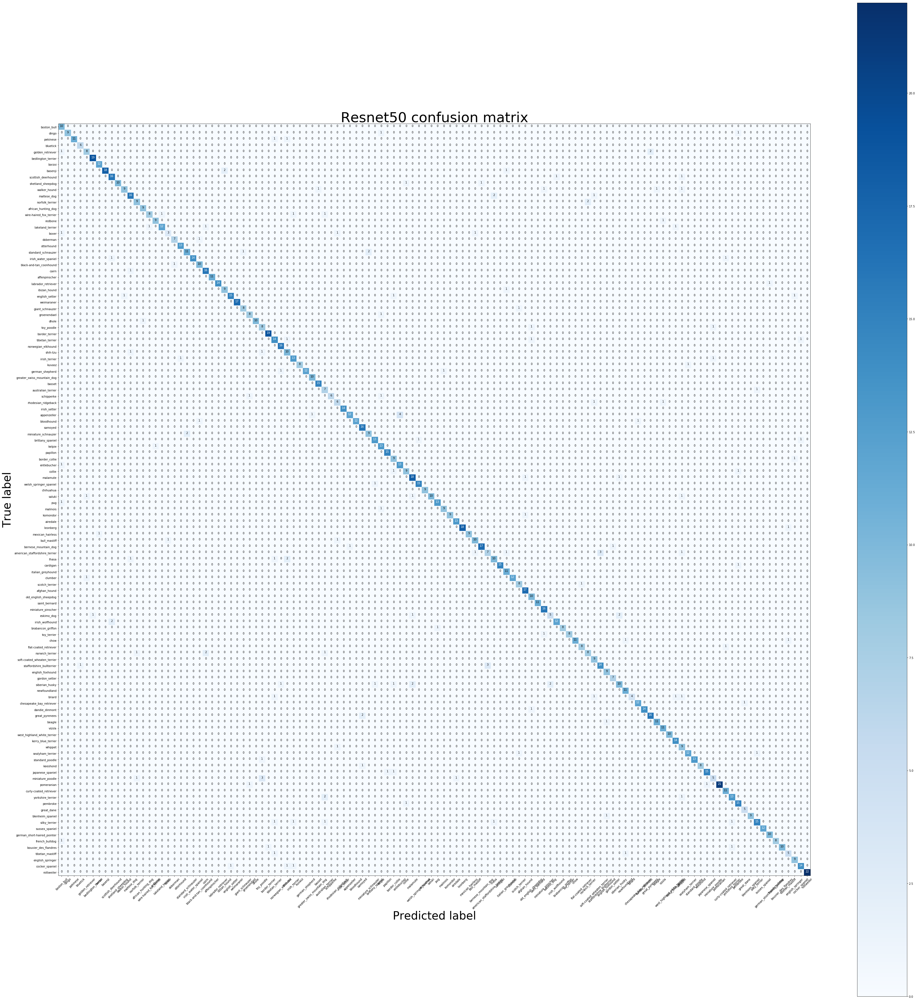

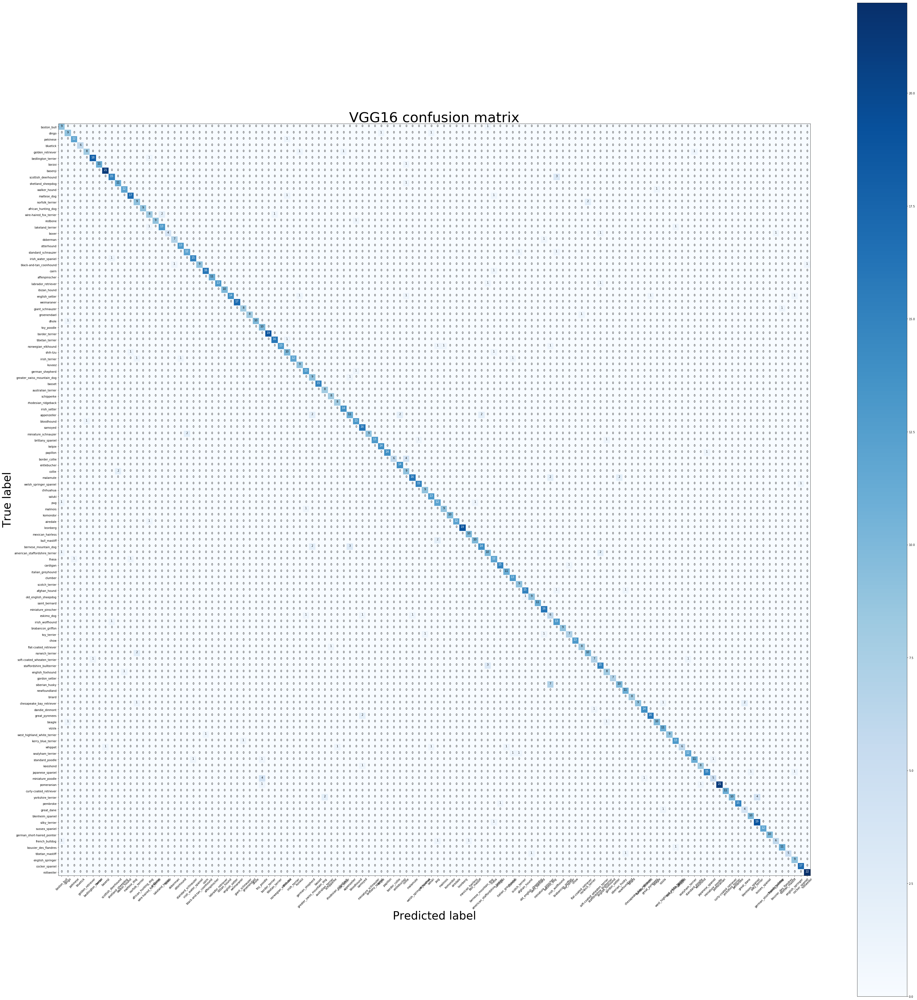

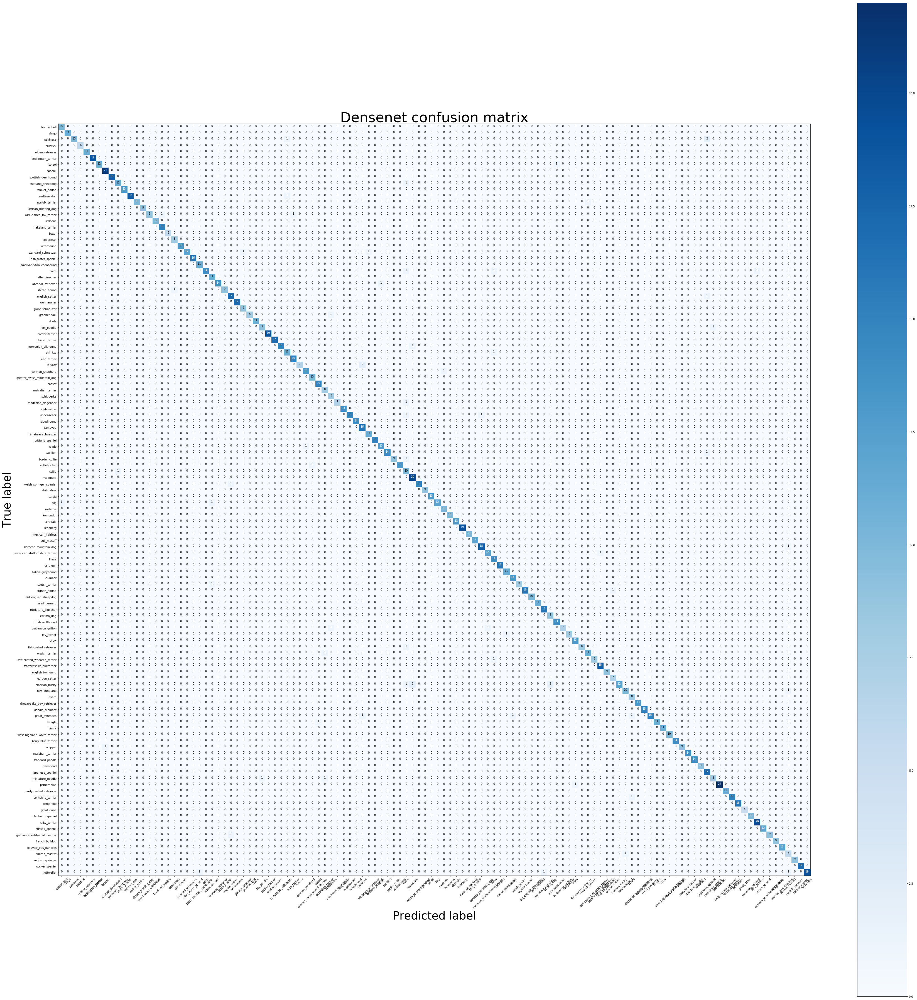

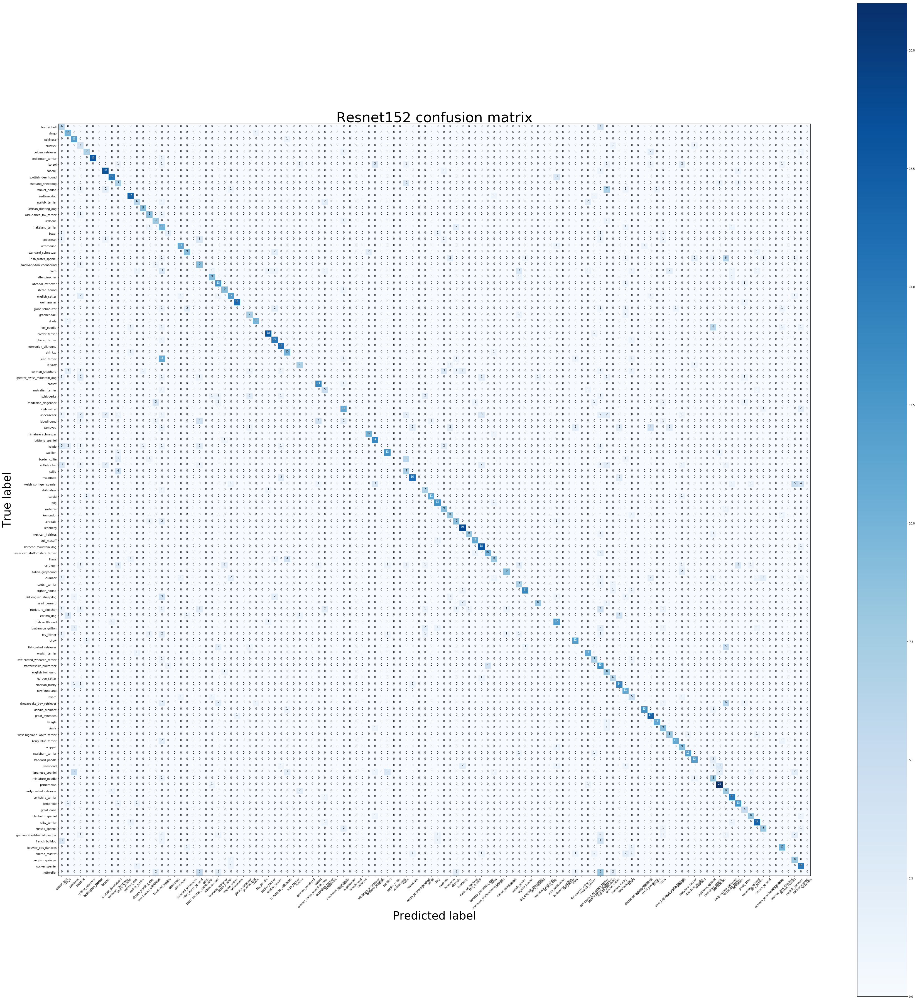

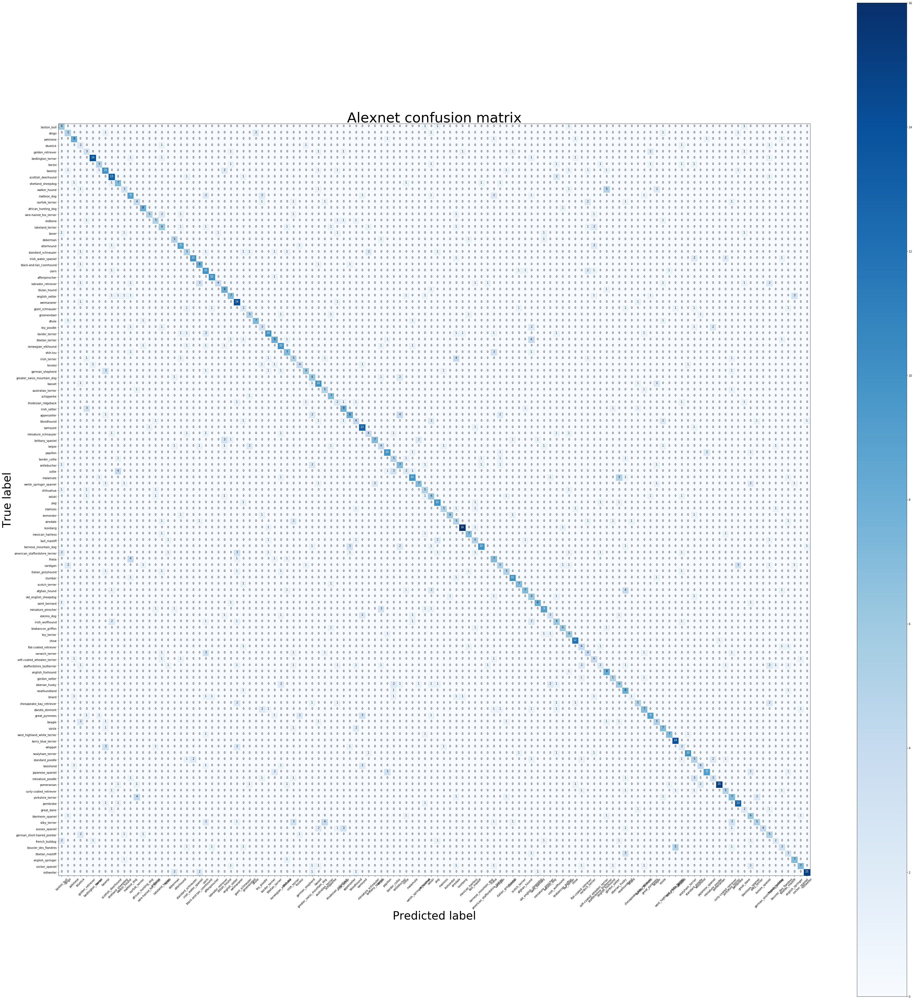

In [9]:
# calculate and plot confusion matrices
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, title="Resnet50 confusion matrix")
plot_confusion_matrix(vgg_model, dataloaders["test"], class_names, title="VGG16 confusion matrix")
plot_confusion_matrix(densenet_model, dataloaders["test"], class_names, title="Densenet confusion matrix")
plot_confusion_matrix(resnet152_model, dataloaders["test"], class_names, title="Resnet152 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, title="Alexnet confusion matrix")

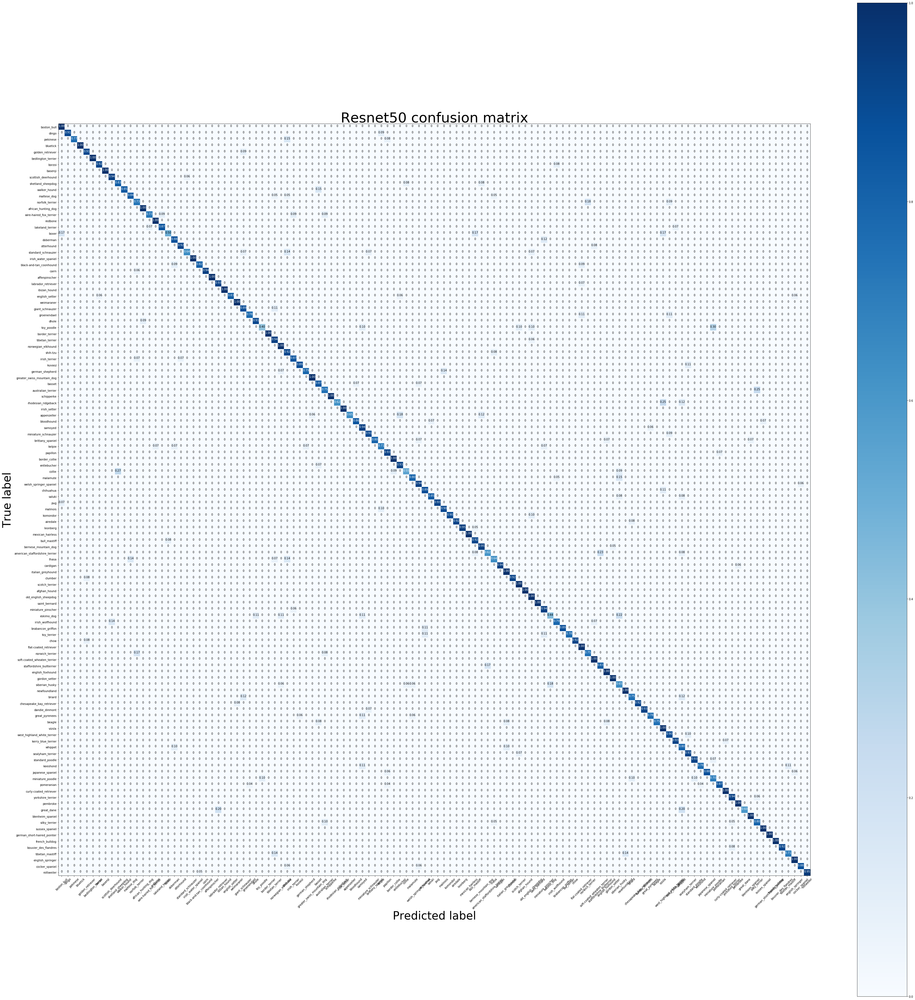

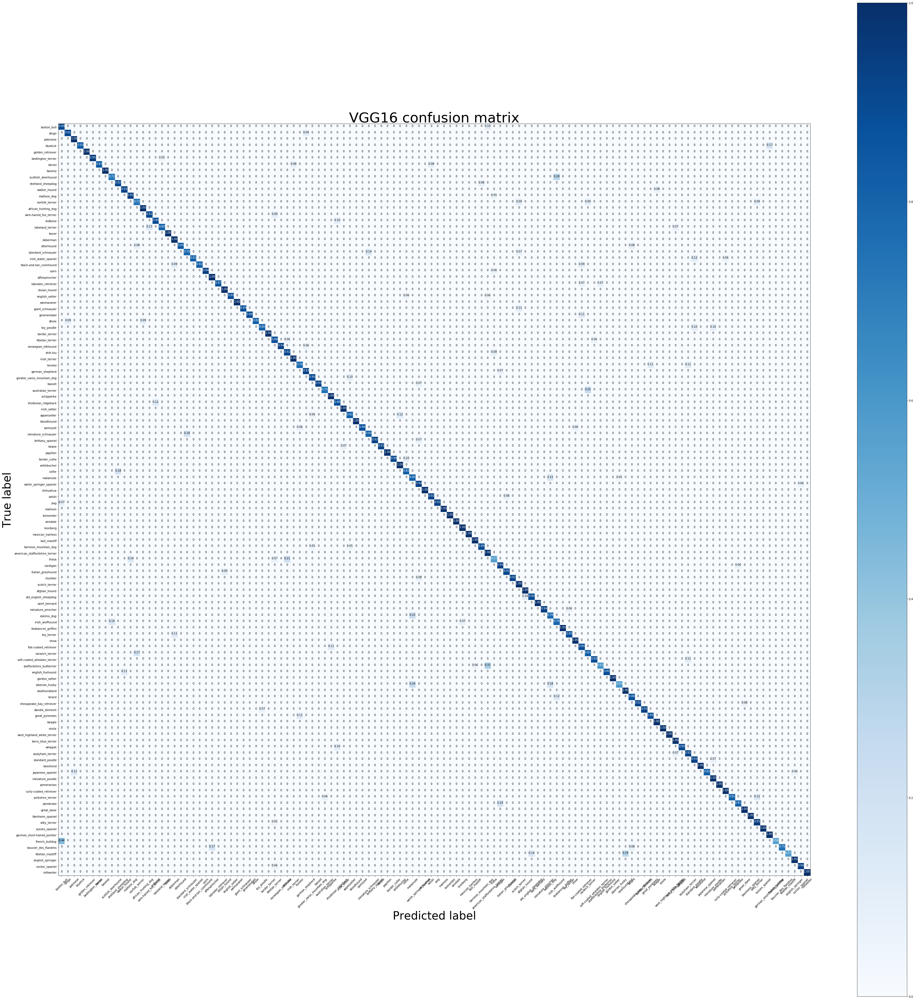

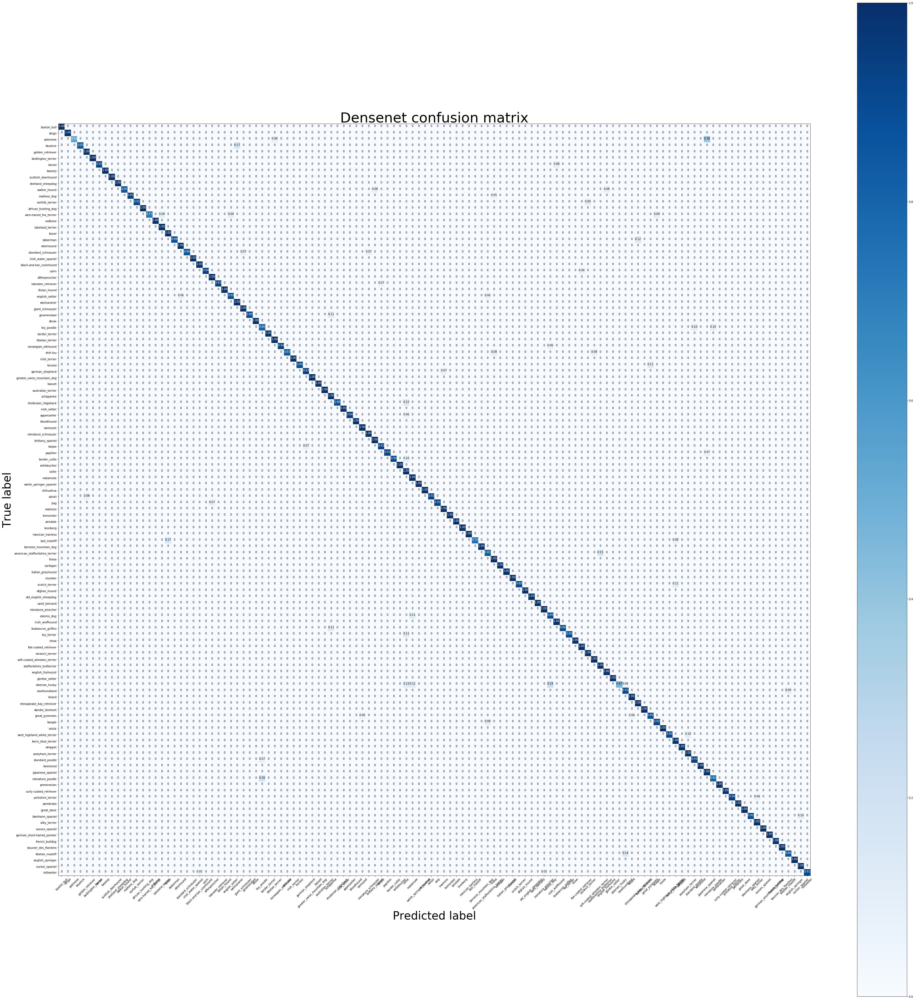

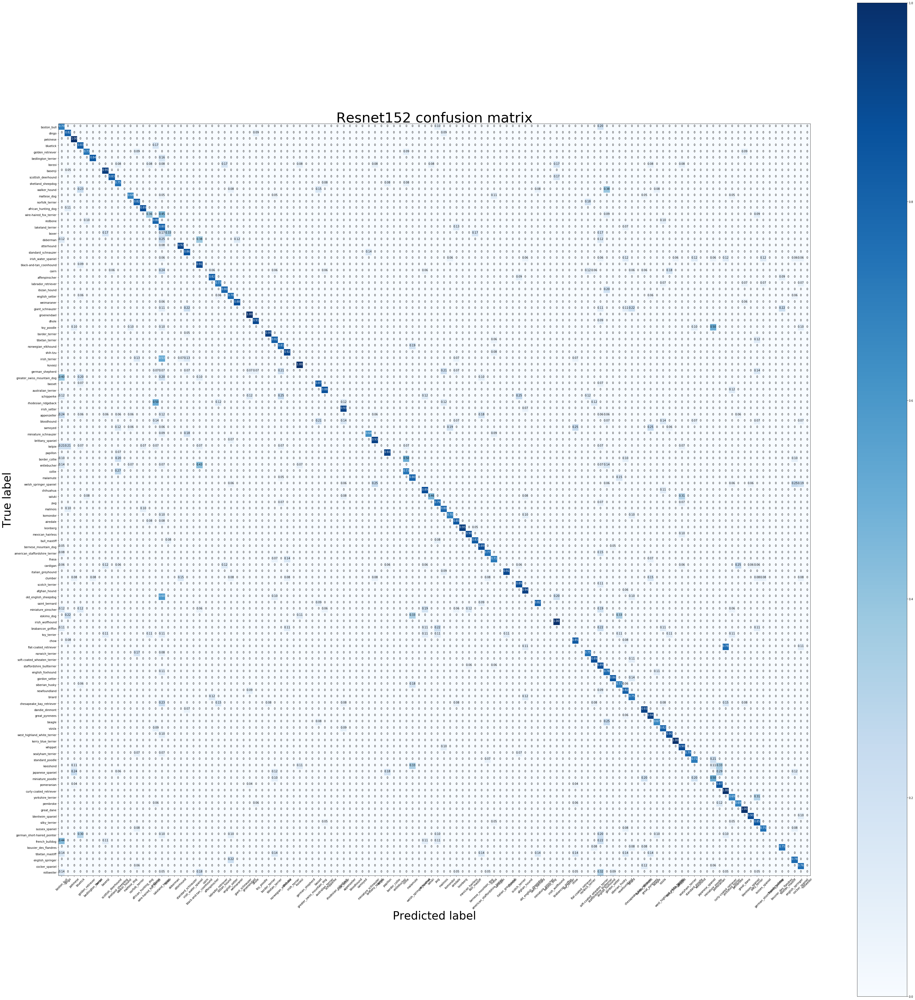

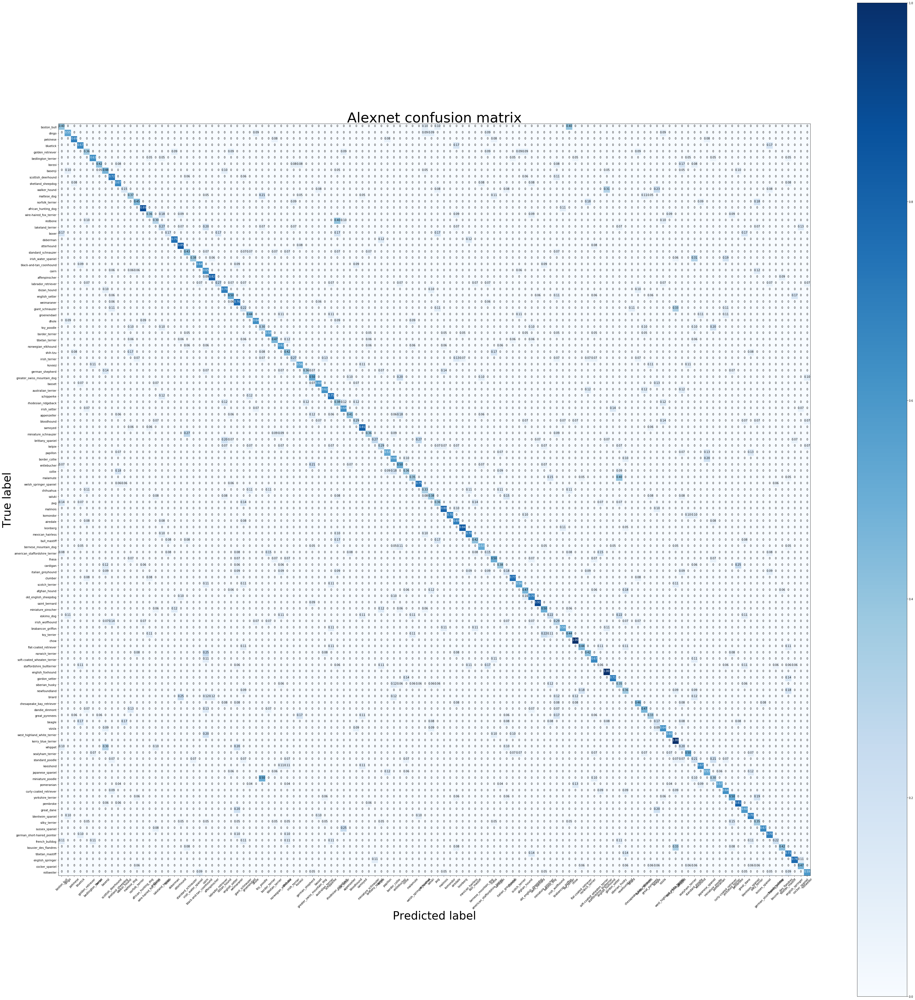

In [21]:
# create normalized confusion matrices
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, normalize=True, title="Resnet50 confusion matrix")
plot_confusion_matrix(vgg_model, dataloaders["test"], class_names, normalize=True, title="VGG16 confusion matrix")
plot_confusion_matrix(densenet_model, dataloaders["test"], class_names, normalize=True, title="Densenet confusion matrix")
plot_confusion_matrix(resnet152_model, dataloaders["test"], class_names, normalize=True, title="Resnet152 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, normalize=True, title="Alexnet confusion matrix")

### classification results

Here I evaluate the results. Visualize_classifications function will visualize models classifications both correct and incorrect. In short, the function goes through the testloader and lists the first 6 images of either correct or incorrect nature. If in incorrect mode, a image of classified breed is also shown to display better the accuracy of the model.

In [110]:
def get_real_breed(breed):
    found = False
    for _ in range(len(dataloaders["train"])):
        images, labels = iter(dataloaders["train"]).next()
        for j in range(images.size()[0]):
            if class_names[labels.data[j]] == breed:
                return images.cpu().data[j]

In [115]:
rcParams['figure.figsize'] = 20, 20
def visualize_classifications(model, correct=True):
    count = 6
    model.eval()
    classification = 0
    fig = plt.figure()

    for _, data in enumerate(dataloaders['test']):
        inputs, labels = data
        inputs, labels = Variable(inputs.cuda()), Variable(labels.cuda())
        outputs = model(inputs)
        _, preds = torch.max(outputs.data, 1)
        
        for j in range(inputs.size()[0]):
            if correct:
                check = (class_names[preds[j]] == class_names[labels.data[j]])
            else:
                check = (class_names[preds[j]] != class_names[labels.data[j]])
            if check:
                classification += 1
                ax = plt.subplot(count//2, 2, classification)
                ax.axis('off')
                ax.set_title('predicted: {}, actual: {}'.format(class_names[preds[j]], class_names[labels.data[j]]))
                show_images(inputs.cpu().data[j])
                if not correct:
                    ax2 = plt.subplot(count//2, 2, classification)
                    ax2.axis('off')
                    ax2.set_title('actual {}'.format(class_names[labels.data[j]]))
                    show_images(get_real_breed(class_names[labels.data[j]]))
                    ax3 = plt.subplot(count//2, 2, classification)
                    ax3.axis('off')
                    ax3.set_title('actual {}'.format(class_names[preds[j]]))
                    show_images(get_real_breed(class_names[preds[j]]))
                if classification != count:
                    print(' --------------------')
                    print('|       NEXT         |')
                    print(' --------------------')

            if classification == count:
                return

### Visualizing models
When visualizing models, it can be seen that most of the errors are from very similar breeds. It is also apparent that some images are not very good - they contain multiple dogs or other entities, or the dog is badly visible or a puppy. Still, most of the faults are from clearly similar dogs.

I did not keep the correct visualization - parts since they did not bring anything fascinating to the mix. They can be easily brought back by uncommenting them.

#### Alexnet mistakes

Alexnet does not impress with its mistakes. Many of the mistakes below do not look at all like the breed. With accuracy of lowly 55%, it is not clearly as good as the rest of the models.

Despite its poor accuracy, it is still clear

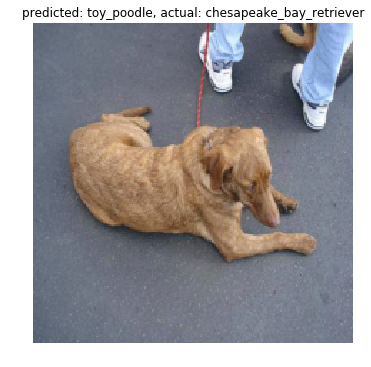

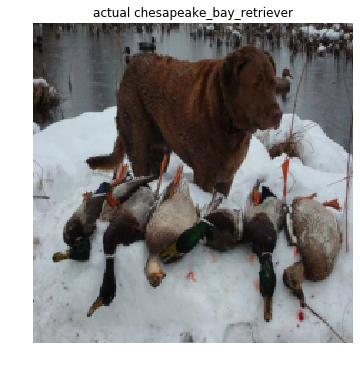

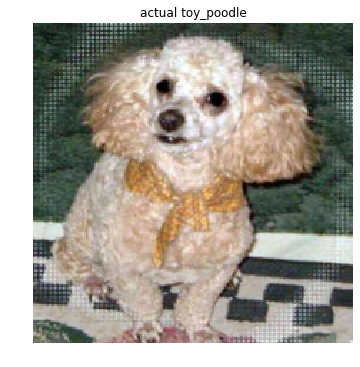

 --------------------
|       NEXT         |
 --------------------


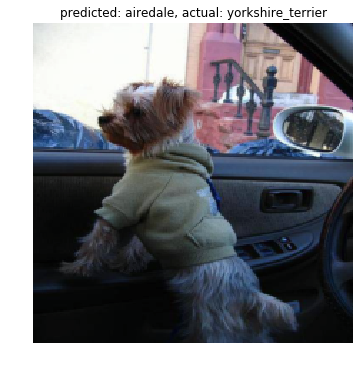

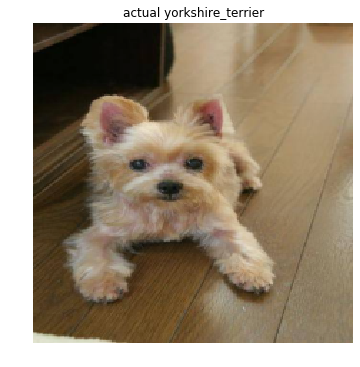

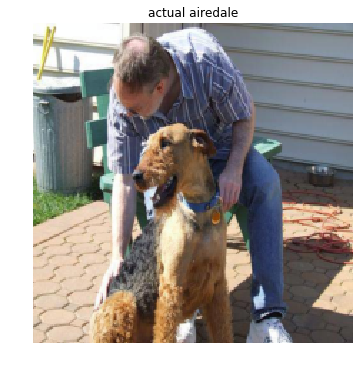

 --------------------
|       NEXT         |
 --------------------


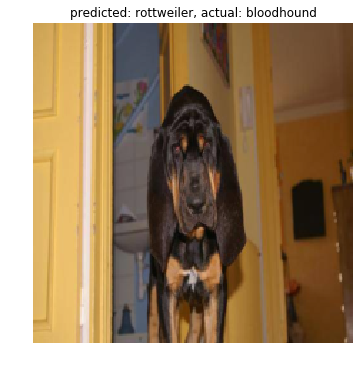

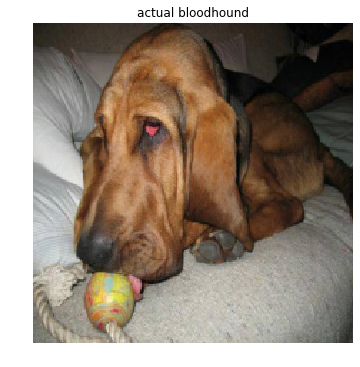

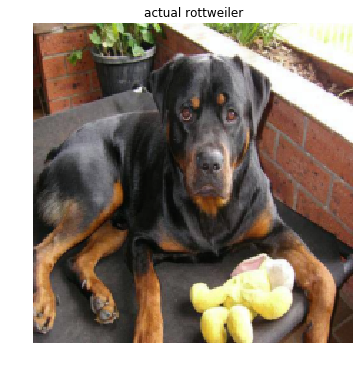

 --------------------
|       NEXT         |
 --------------------


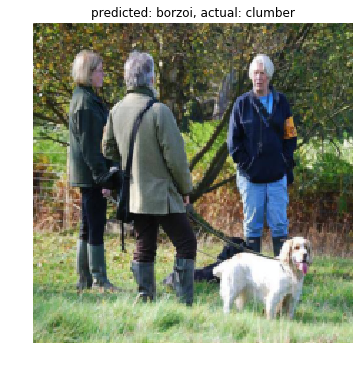

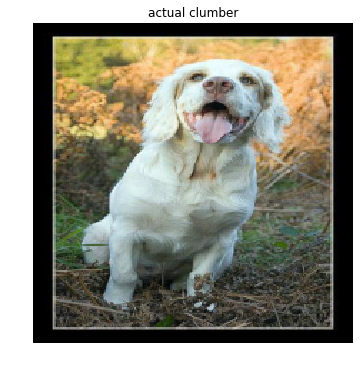

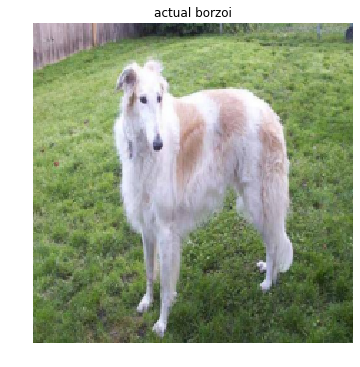

 --------------------
|       NEXT         |
 --------------------


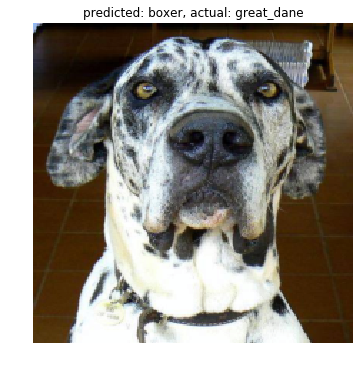

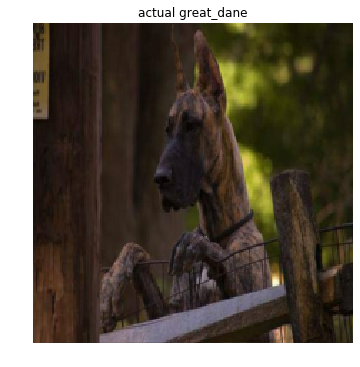

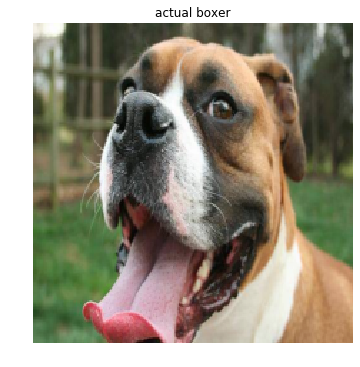

 --------------------
|       NEXT         |
 --------------------


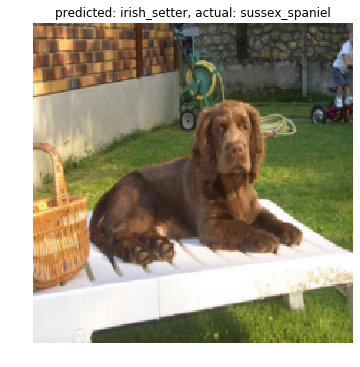

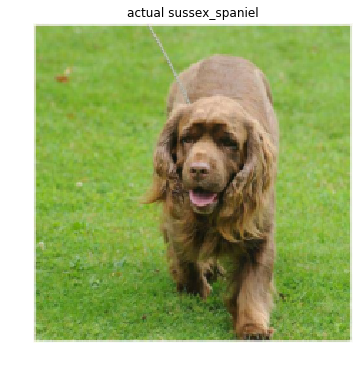

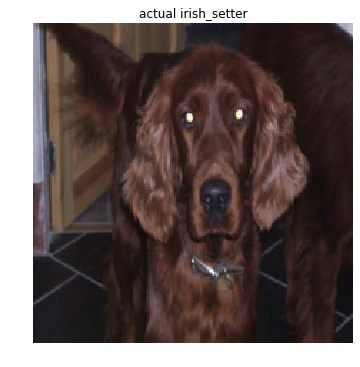

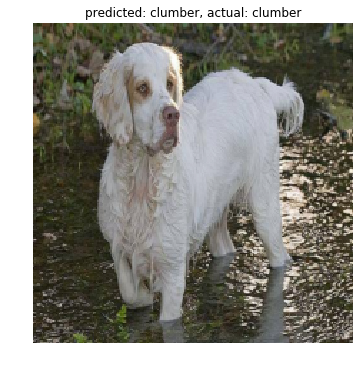

 --------------------
|       NEXT         |
 --------------------


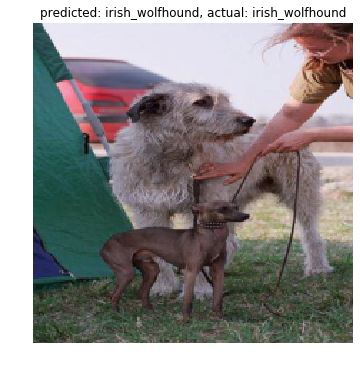

 --------------------
|       NEXT         |
 --------------------


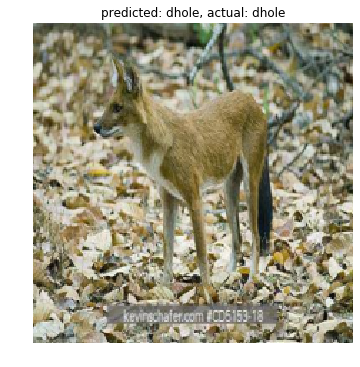

 --------------------
|       NEXT         |
 --------------------


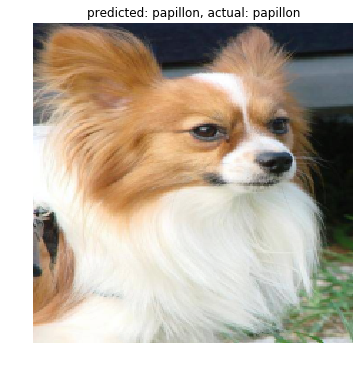

 --------------------
|       NEXT         |
 --------------------


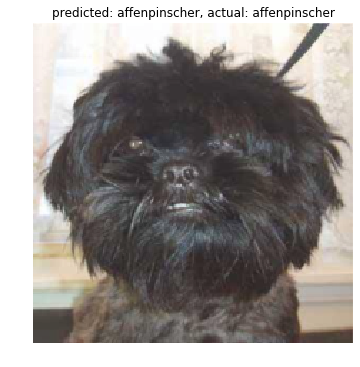

 --------------------
|       NEXT         |
 --------------------


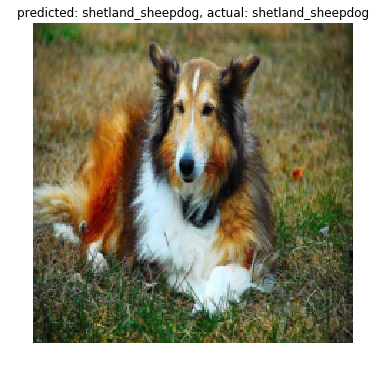

In [146]:
# Alexnet mistakes
visualize_classifications(alexnet_model, correct=False)
# Alexnet succesful
visualize_classifications(alexnet_model, correct=True)

#### densenet mistakes

Densenet's mistakes are all very small, in this set mostly huskies/malamutes, -spaniels, pyrenees/samoyeds and -retrievers mistaken for one another.

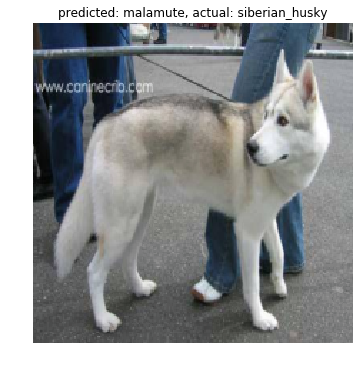

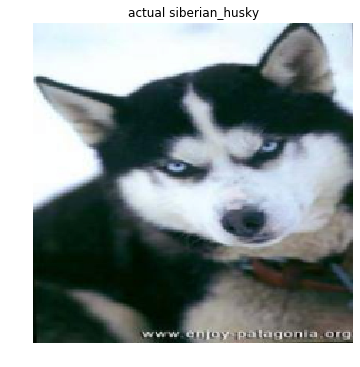

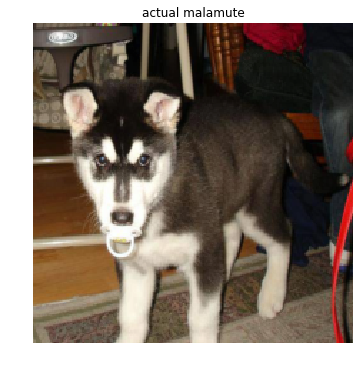

 --------------------
|       NEXT         |
 --------------------


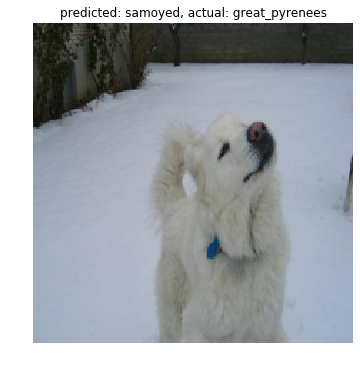

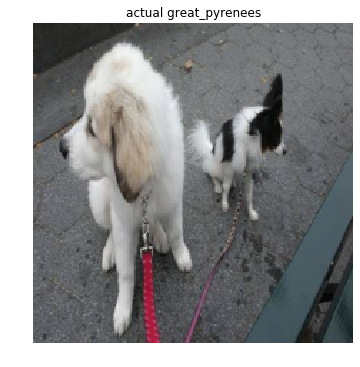

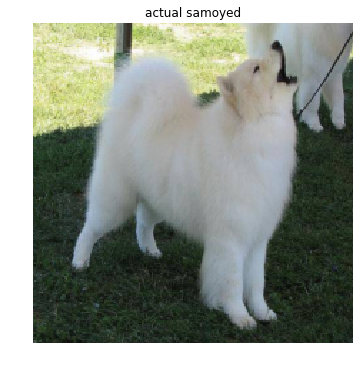

 --------------------
|       NEXT         |
 --------------------


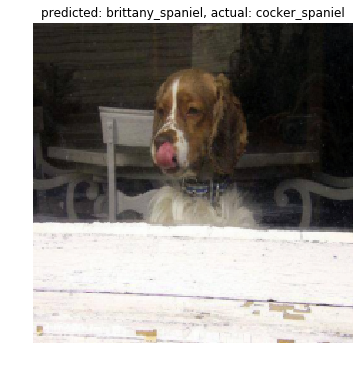

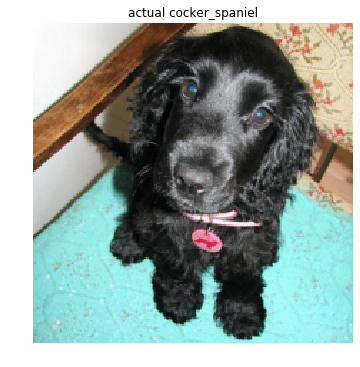

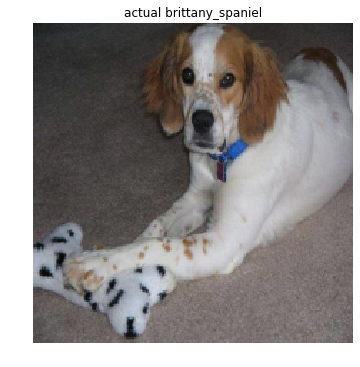

 --------------------
|       NEXT         |
 --------------------


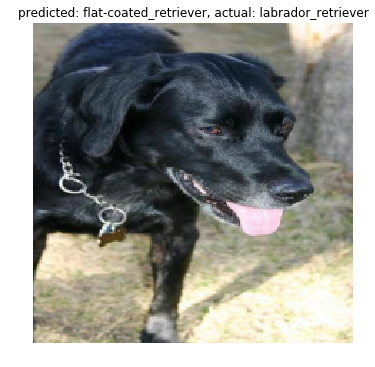

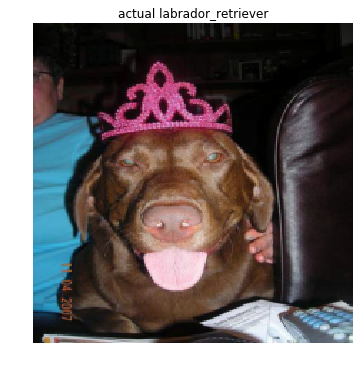

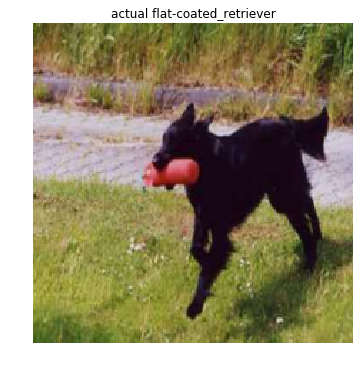

 --------------------
|       NEXT         |
 --------------------


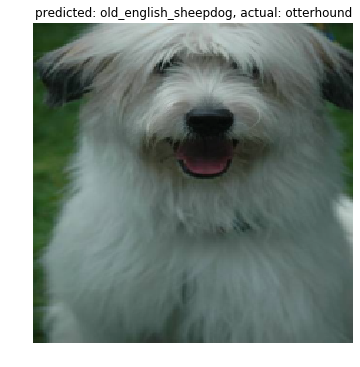

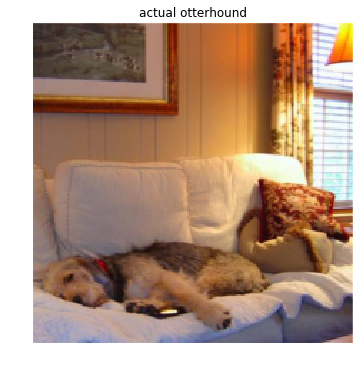

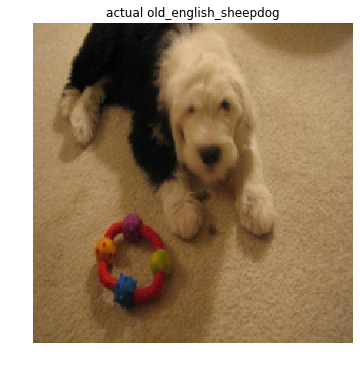

 --------------------
|       NEXT         |
 --------------------


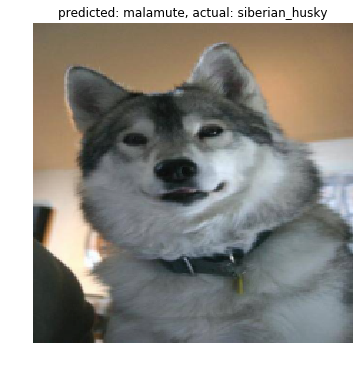

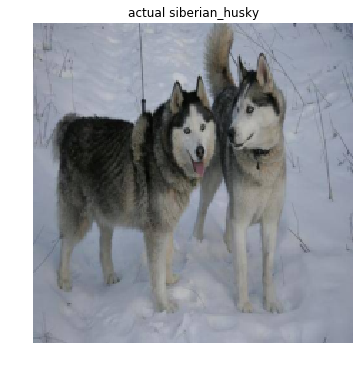

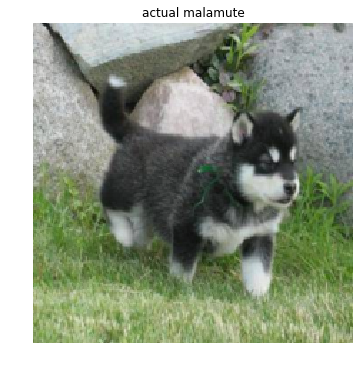

In [117]:
visualize_classifications(densenet_model, correct=False)
# visualize_classifications(densenet_model, correct=True)

#### resnet50 mistakes

Once again, multiple misclassifications were from similar breeds. Also, one can note many of the misclassified images are not very good, containing extraneous dogs and humans.

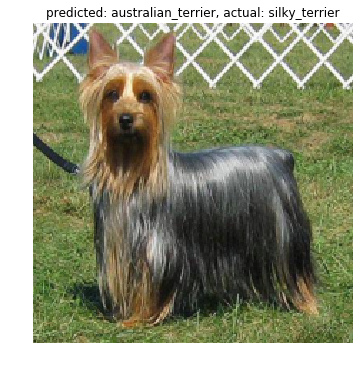

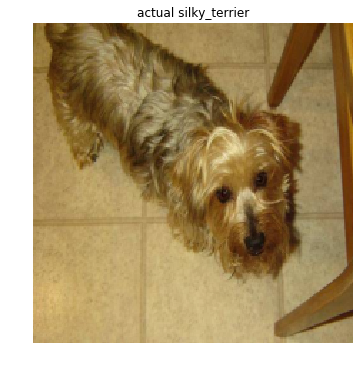

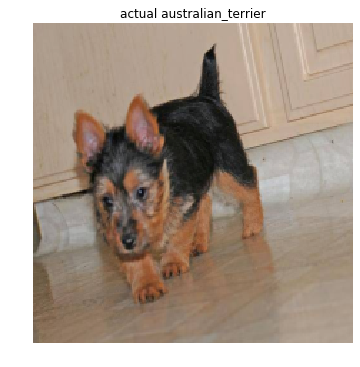

 --------------------
|       NEXT         |
 --------------------


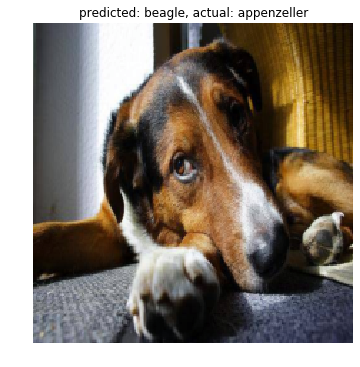

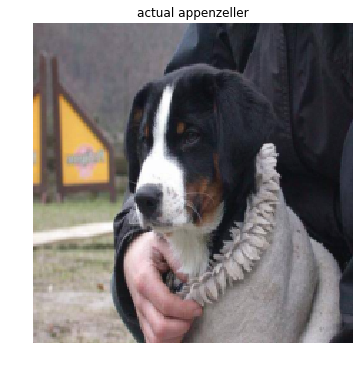

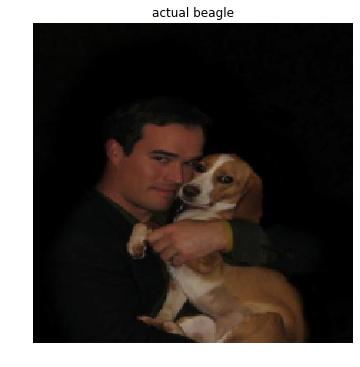

 --------------------
|       NEXT         |
 --------------------


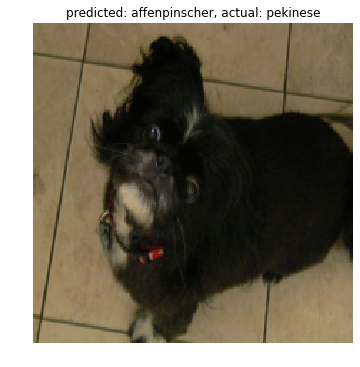

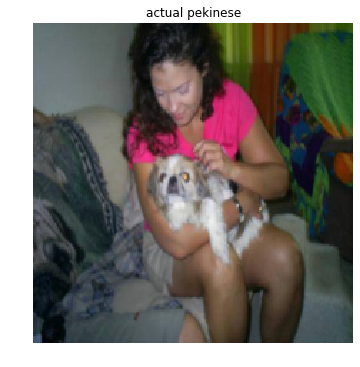

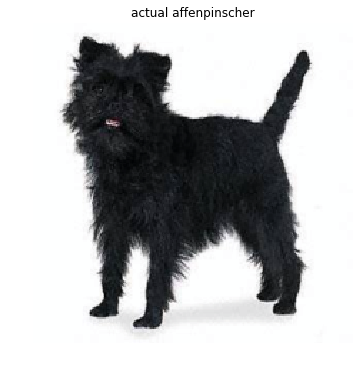

 --------------------
|       NEXT         |
 --------------------


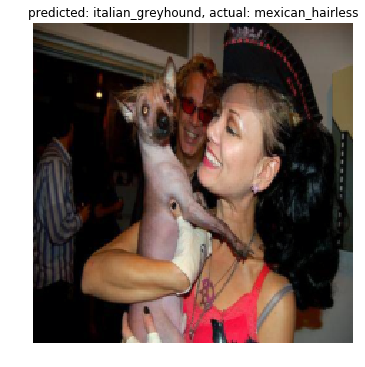

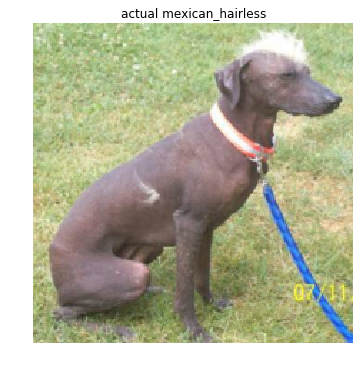

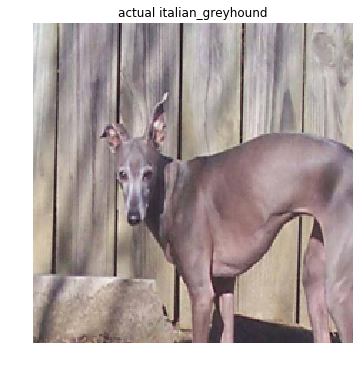

 --------------------
|       NEXT         |
 --------------------


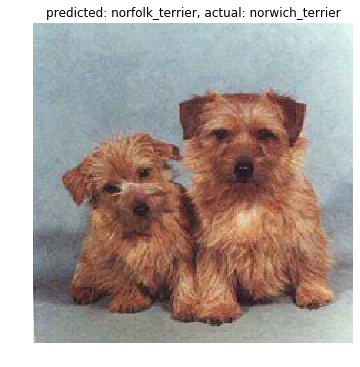

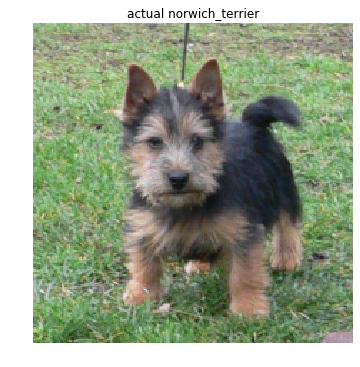

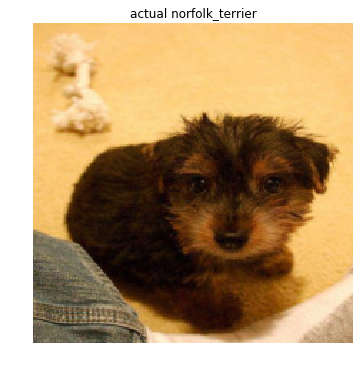

 --------------------
|       NEXT         |
 --------------------


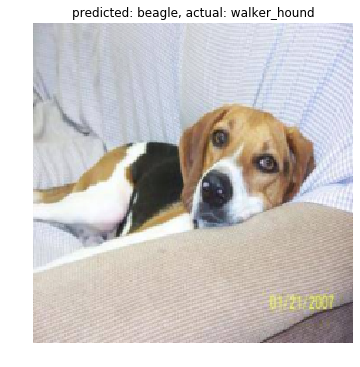

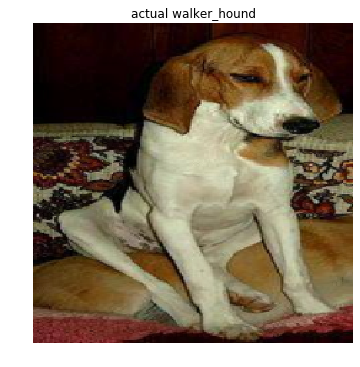

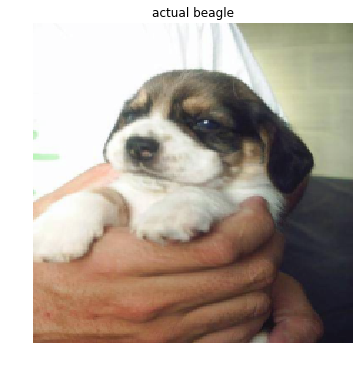

In [118]:
visualize_classifications(resnet_model, correct=False)
# visualize_classifications(resnet_model, correct=True)

#### resnet152 mistakes

The trend continues... In the current set one exception is the kelpie-curly-coated_retriever mixup.

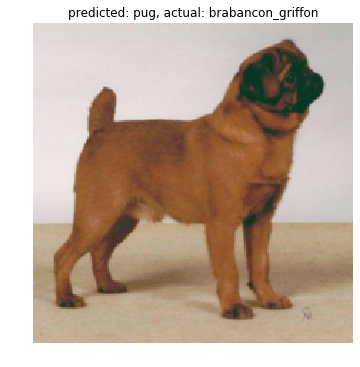

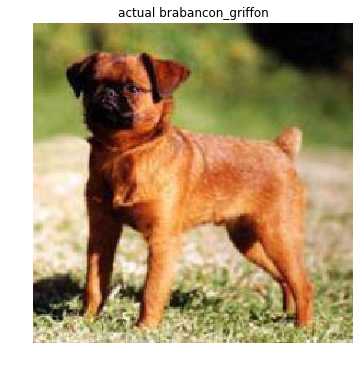

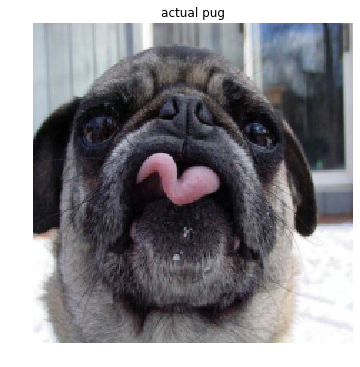

 --------------------
|       NEXT         |
 --------------------


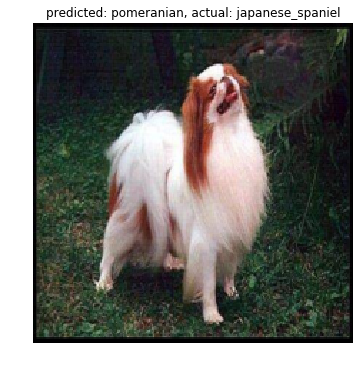

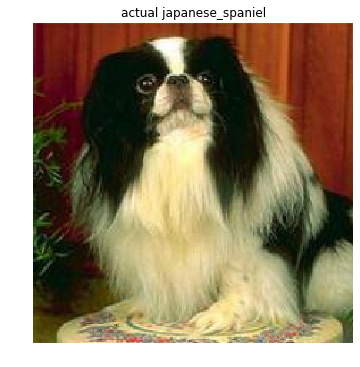

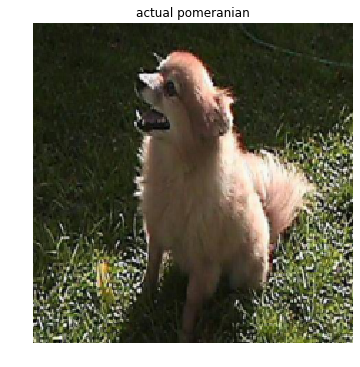

 --------------------
|       NEXT         |
 --------------------


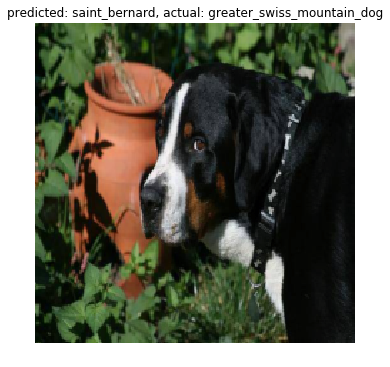

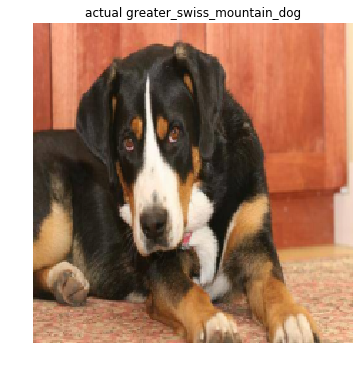

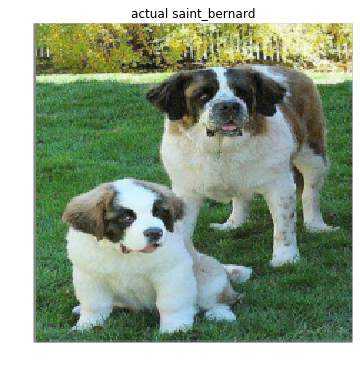

 --------------------
|       NEXT         |
 --------------------


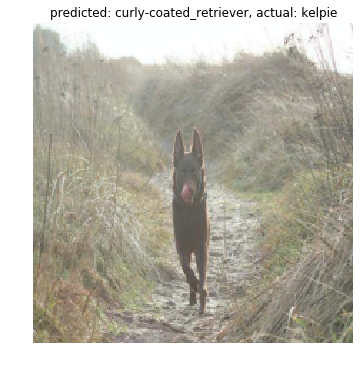

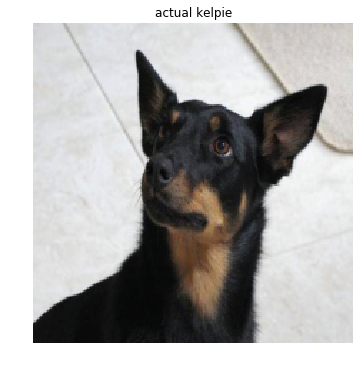

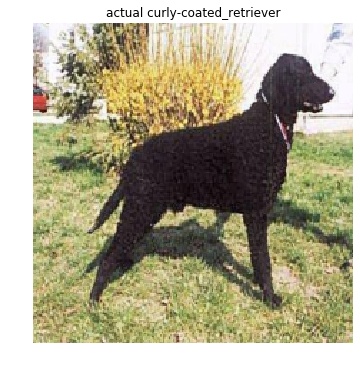

 --------------------
|       NEXT         |
 --------------------


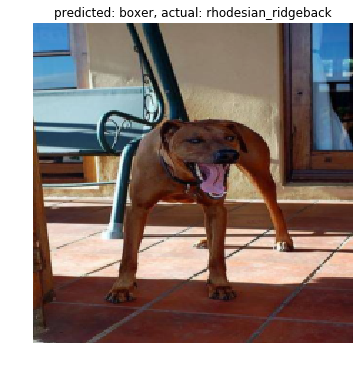

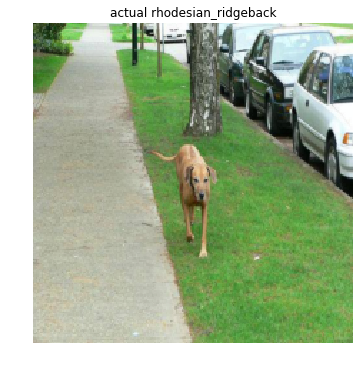

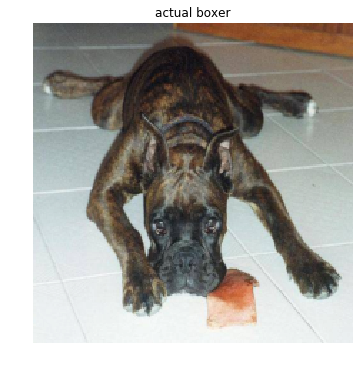

 --------------------
|       NEXT         |
 --------------------


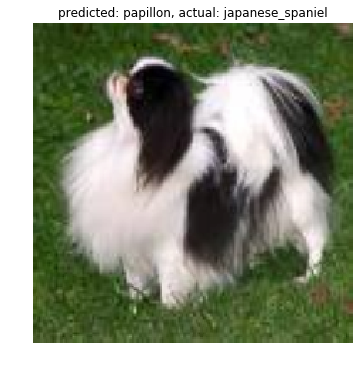

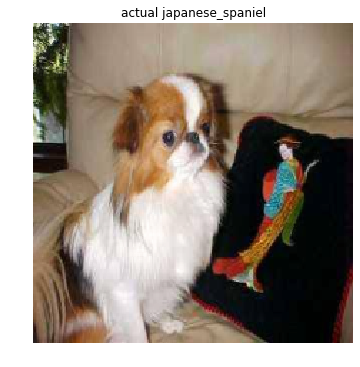

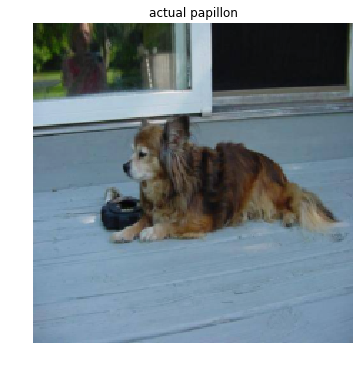

In [119]:
visualize_classifications(resnet152_model, correct=False)
# visualize_classifications(resnet152_model, correct=True)

### Classification mistakes roundup

To summarize: the models did a good job identifying breeds. I dont expect humans to do much better in identifying breeds. Most of the incorrect classifications were due similar breeds and bad image quality. Regardless, the models performed quite well.

### Accuracy

Next we compute the model's accuracy with the test data. This is done using the same function used in the course material.

In [89]:
def compute_accuracy(model, testloader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in testloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return correct / total


In [144]:
# Computing the accuracy of each model
acc_alexnet = compute_accuracy(alexnet_model, dataloaders['test'])
acc_resnet152 = compute_accuracy(resnet152_model, dataloaders['test'])
acc_resnet50 = compute_accuracy(resnet_model, dataloaders['test'])
acc_densenet = compute_accuracy(densenet_model, dataloaders['test'])
acc_vgg = compute_accuracy(vgg_model, dataloaders['test'])

In [145]:
# Printing results
print("accuracy of alexnet was {}".format(acc_alexnet))
print("accuracy of resnet152 was {}".format(acc_resnet152))
print("accuracy of resnet50 was {}".format(acc_resnet50))
print("accuracy of densenet was {}".format(acc_densenet))
print("accuracy of vgg was {}".format(acc_vgg))

accuracy of alexnet was 0.5557729941291585
accuracy of resnet152 was 0.6999347684279191
accuracy of resnet50 was 0.9223744292237442
accuracy of densenet was 0.9706457925636007
accuracy of vgg was 0.95955642530985


| Model |Accuracy |
| --- | --- |
| 'Densenet' | 97.06% |
| 'Resnet50' | 92.23 |
| 'VGG16' | {{ acc_vgg }} |
| 'Alexnet' | {{ acc_alexnet }} |
| 'Resnet152' | {{ acc_resnet152 }} |

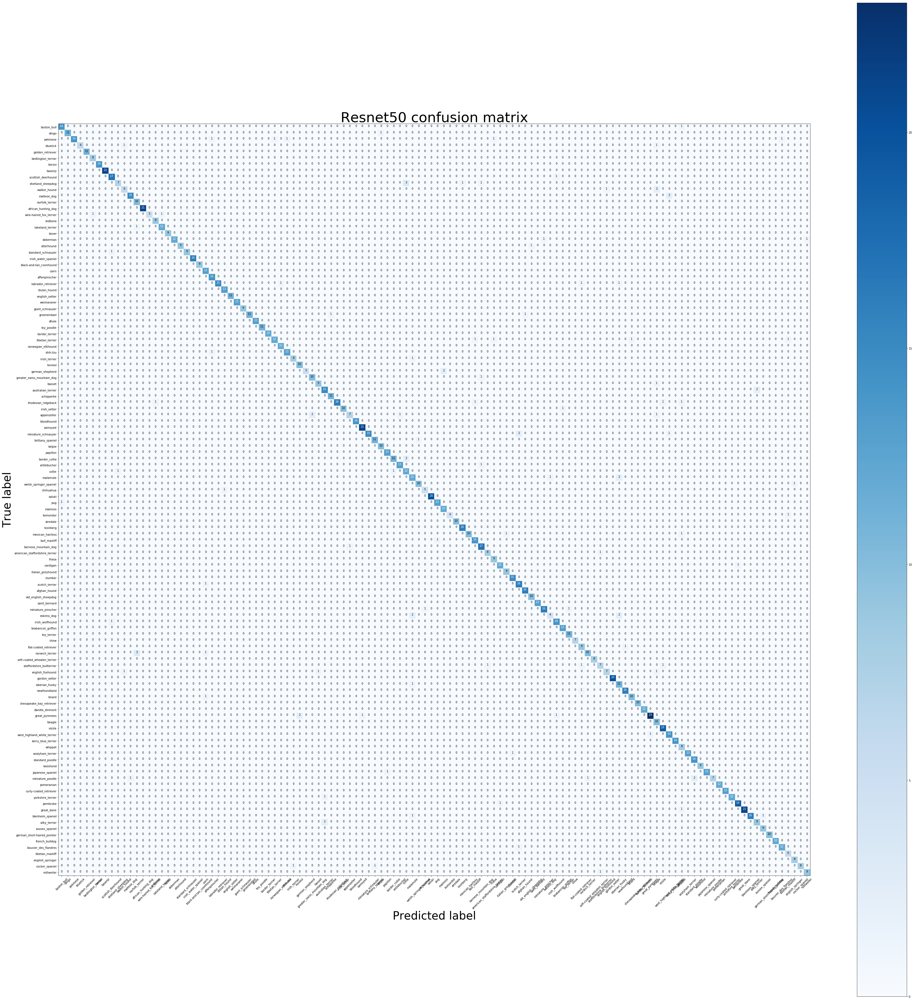

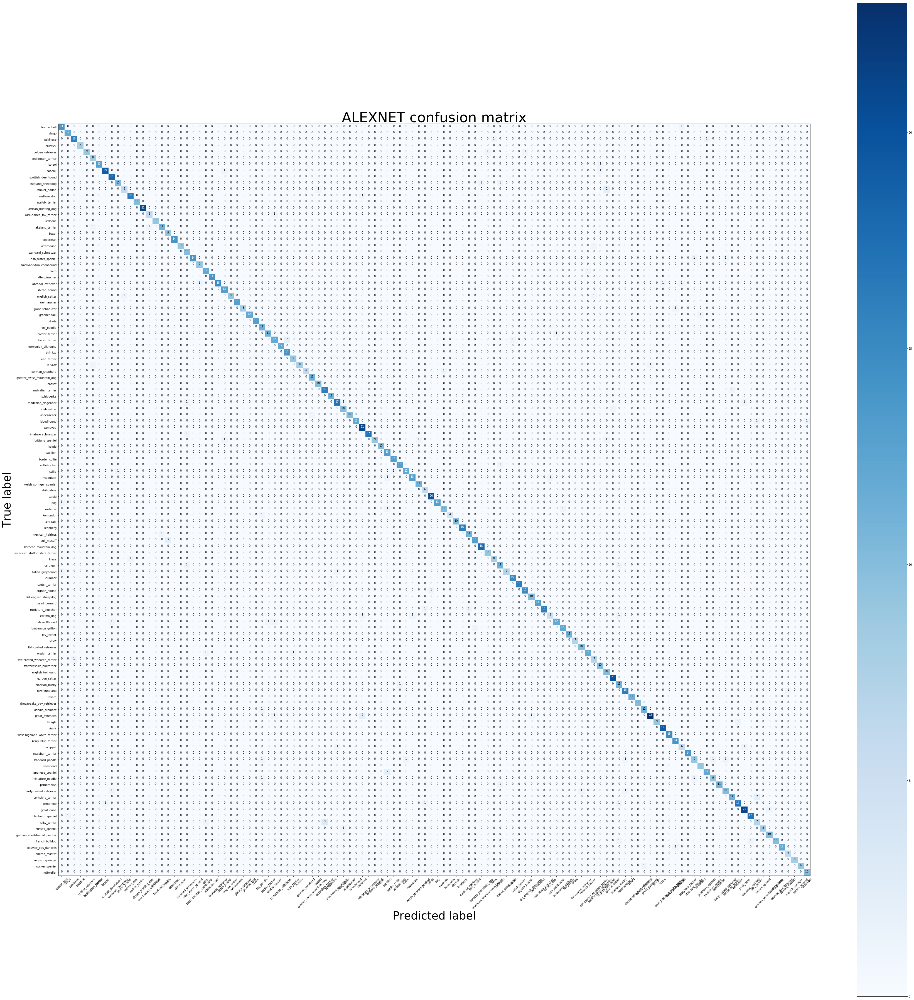

In [141]:
#del resnet_model
#del alexnet_model
resnet_model = torch.load('resnet50-2.pth')
alexnet_model = torch.load('alexnet-2.pth')
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, title="Resnet50 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, title="ALEXNET confusion matrix")

In [ ]:
## plot_confusion_matrix(densenet_model, dataloaders["test"], class_names, title="DENSENET confusion matrix")

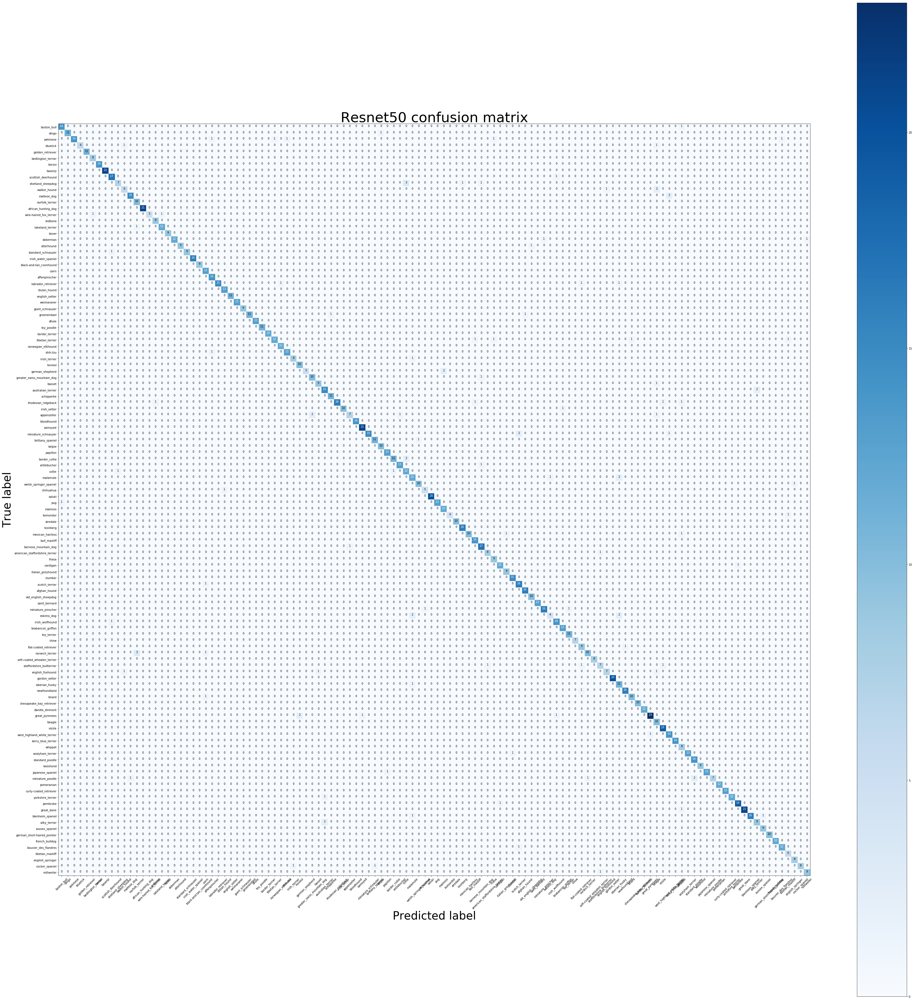

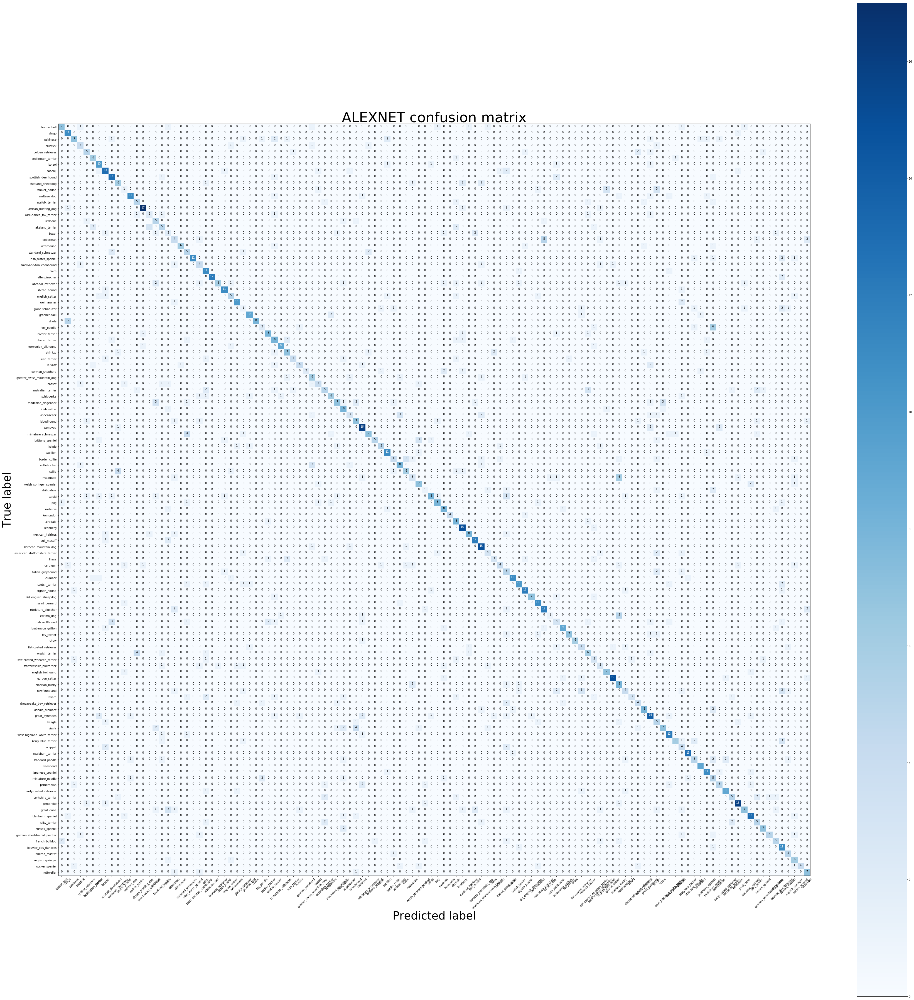

In [142]:
resnet_model = torch.load('resnet50-2.pth')
alexnet_model = torch.load('alexnet-2.pth')
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, title="Resnet50 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, title="ALEXNET confusion matrix")